In [1]:
#"A000100_유한양행",
'''
"A000120_대한통운",
"A000270_기아차",
"A000660_SK하이닉스",
"A000720_현대건설",
"A000810_삼성화재",
"A002790_아모레G",
#"A003410_쌍용양회",
"A003490_대한항공",
"A003550_LG",
"A003670_포스코케미칼",
"A004020_현대제철",
"A004990_롯데지주",
"A005380_현대차",
"A005387_현대차2우B",
"A005490_POSCO",
"A005830_DB손해보험",
"A005930_삼성전자",
"A005935_삼성전자우",
"A005940_NH투자증권",
"A006280_녹십자",
"A006360_GS건설",
"A006400_삼성SDI",
"A006800_미래에셋대우",
"A007070_GS리테일",
"A008560_메리츠증권",
"A008770_호텔신라",
"A008930_한미사이언스",
"A009150_삼성전기",
"A009540_한국조선해양",
"A009830_한화솔루션", #여기까지
"A010130_고려아연",
"A010140_삼성중공업",
"A010950_S-Oil",
"A011070_LG이노텍",
"A011170_롯데케미칼",
"A011200_HMM",
"A011780_금호석유",
"A011790_SKC",
"A012330_현대모비스",
"A012510_더존비즈온",
"A012750_에스원",
"A015760_한국전력",
"A016360_삼성증권",
 "A017670_SK텔레콤",
"A018260_삼성에스디에스",
"A018880_한온시스템",
"A019170_신풍제약", #안돼'''
data_list =[
"A035420_NAVER",
"A035720_카카오",
"A036460_한국가스공사",
"A036570_엔씨소프트",
"A039490_키움증권",
"A047810_한국항공우주",
"A051900_LG생활건강",
"A051910_LG화학",
"A055550_신한지주",
"A066570_LG전자",
"A068270_셀트리온",
"A071050_한국금융지주",
"A078930_GS",
"A086280_현대글로비스",
"A086790_하나금융지주",
"A090430_아모레퍼시픽",
"A096770_SK이노베이션",
"A097950_CJ제일제당",
"A105560_KB금융",
"A128940_한미약품",
"A139480_이마트",
"A161390_한국타이어앤테크놀로지",
"A180640_한진칼",
"A204320_만도"]
jongmoc_list = []
for i in range(len(data_list)):
    jongmoc_list.append(data_list[i][:7])
#data_list[i][1:] #그래프에 넣을 이름

for i in range(len(data_list)):
    jongmoc = jongmoc_list[i]
    #print(jongmoc)
    #print(data_list[i][1:])

In [2]:

import os
import warnings

warnings.filterwarnings("ignore")

#os.chdir("../../..")

import sys
#!{sys.executable} -m pip install bayesian-Optimization
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import datetime
from datetime import datetime
from random import randint, uniform
import datetime
#from sklearn.externals import joblib
import joblib

plt.rc('font', family='NanumBarunGothic')
from lightgbm import LGBMRegressor
import lightgbm as lgb
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic')

from joblib import Memory
location = './cachedir'
memory = Memory(location, verbose=0)

In [3]:

from bayes_opt import BayesianOptimization
#!pip install bayesian-optimization
#from bayes_opt import BayesianOptimization

In [4]:
def smape(preds, target):
    '''
    Function to calculate SMAPE
    '''
    n = len(preds)
    masked_arr = ~((preds==0)&(target==0))
    preds, target = preds[masked_arr], target[masked_arr]
    num = np.abs(preds-target)
    denom = np.abs(preds)+np.abs(target)
    smape_val = (200*np.sum(num/denom))/n
    return smape_val

def lgbm_smape(preds, train_data):
    '''
    Custom Evaluation Function for LGBM
    '''
    labels = train_data.get_label()
    smape_val = smape(np.expm1(preds), np.expm1(labels))
    return 'SMAPE', smape_val, False

def rmse1(y_pred, dataset):
    y_true = dataset.get_label()

    diff = abs(y_true - y_pred)
    less_then_one = np.array([0 if x < 1 else 1 for x in diff])

    y_pred = less_then_one * y_pred
    y_true = less_then_one *y_true
    
    score= np.sqrt(mean_squared_error(y_true, y_pred))
    
    return 'score', score, False

def objective2(trial):
    train_x = a
    train_y = b
    test_x = c
    test_y = d
    if d.isnull().values.any()==True: 
        rmse = 100000000000000
        return rmse
    else:
        #train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.2,random_state=42)
        param = {
            'metric': 'rmse', 
            'random_state': 48,
            'n_estimators': trial.suggest_int('n_estimators', 1000, 3000),
            'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
            'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),
            'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1.0]),
            'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
            'learning_rate': trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02]),
            'max_depth': trial.suggest_categorical('max_depth', [10,15,20]),
            'num_leaves' : trial.suggest_int('num_leaves', 10, 100),
            'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
            #'cat_smooth' : trial.suggest_int('min_data_per_groups', 1, 100)
        }
        model = LGBMRegressor(**param)  

        model.fit(train_x,train_y,eval_set=[(test_x,test_y)],early_stopping_rounds=100,verbose=False)
        #print(train_x[0])
        #last_train_x = train_x.loc[(-1*int(test_y.shape[0])):-1]
        preds = model.predict(test_x)
        rmse = mean_squared_error(test_y, preds,squared=False)

        return rmse

## Function to reduce the DF size
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

# lags 
# site 별로 최근 3일간의 날씨를 rolling 하기
def add_lag_feature(weather_df, cols, window=3):
    #group_df = weather_df.groupby('site_id')
    rolled = weather_df[cols].rolling(window=window, min_periods=0)
    lag_mean = rolled.mean().reset_index().astype(np.float16)
    lag_max = rolled.max().reset_index().astype(np.float16)
    lag_min = rolled.min().reset_index().astype(np.float16)
    lag_std = rolled.std().reset_index().astype(np.float16)
    for col in cols:
        weather_df[f'{col}_mean_lag{window}'] = lag_mean[col]
        weather_df[f'{col}_max_lag{window}'] = lag_max[col]
        weather_df[f'{col}_min_lag{window}'] = lag_min[col]
        weather_df[f'{col}_std_lag{window}'] = lag_std[col]

from bayes_opt import BayesianOptimization
def bayesion_opt_lgbm(X, y, init_iter=3, n_iters=7, random_state=11, seed = 101, num_iterations = 100):
  dtrain = lgb.Dataset(data=X, label=y)
  def lgb_r2_score(preds, dtrain):
      labels = dtrain.get_label()
      return 'r2', r2_score(labels, preds), True
  # Objective Function
  def hyp_lgbm(num_leaves, feature_fraction, bagging_fraction, max_depth, min_split_gain, min_child_weight):
        
          params = {'application':'regression','num_iterations': num_iterations,
                    'early_stopping_round':50, 'learning_rate':0.01,
                    'metric':'lgb_r2_score'} # Default parameters
          params["num_leaves"] = int(round(num_leaves,0))
          params['feature_fraction'] = max(min(feature_fraction, 1), 0)
          params['bagging_fraction'] = max(min(bagging_fraction, 1), 0)
          params['max_depth'] = int(round(max_depth))
          params['min_split_gain'] = min_split_gain
          params['min_child_weight'] = min_child_weight
          cv_results = lgb.cv(params, dtrain, nfold=5, seed=seed,categorical_feature=[], stratified=False,
                              verbose_eval =None, feval=lgb_r2_score)
          # print(cv_results)
          return np.max(cv_results['r2-mean'])
  # Domain space-- Range of hyperparameters 
  pds = {   'num_leaves': (50, 150),
            'feature_fraction': (0.1, 0.9),
            'bagging_fraction': (0.8, 1),
            'max_depth': (17, 30),
            'min_split_gain': (0.001, 0.1),
            'min_child_weight': (10, 25)
            }

  # Surrogate model
  optimizer = BayesianOptimization(hyp_lgbm, pds, random_state=random_state)
                                    
  # Optimize
  optimizer.maximize(init_points=init_iter, n_iter=n_iters)

  return optimizer.max['params']

In [5]:
import pandas as pd
import datetime
from datetime import datetime as dt
from dateutil.relativedelta import *

class TimeBasedCV(object):
    '''
    Parameters 
    ----------
    train_period: int
        number of time units to include in each train set
        default is 30
    test_period: int
        number of time units to include in each test set
        default is 7
    freq: string
        frequency of input parameters. possible values are: days, months, years, weeks, hours, minutes, seconds
        possible values designed to be used by dateutil.relativedelta class
        deafault is days
    '''
    
    
    def __init__(self, train_period=30, test_period=7, freq='days'):
        self.train_period = train_period
        self.test_period = test_period
        self.freq = freq

        
        
    def split(self, data, validation_split_date=None, date_column='Date', gap=0):
        '''
        Generate indices to split data into training and test set
        
        Parameters 
        ----------
        data: pandas DataFrame
            your data, contain one column for the record date 
        validation_split_date: datetime.date()
            first date to perform the splitting on.
            if not provided will set to be the minimum date in the data after the first training set
        date_column: string, deafult='record_date'
            date of each record
        gap: int, default=0
            for cases the test set does not come right after the train set,
            *gap* days are left between train and test sets
        
        Returns 
        -------
        train_index ,test_index: 
            list of tuples (train index, test index) similar to sklearn model selection
        '''
        
        # check that date_column exist in the data:
        try:
            data[date_column]
        except:
            raise KeyError(date_column)
                    
        train_indices_list = []
        test_indices_list = []
      

        if validation_split_date==None:
            validation_split_date = data[date_column].min().date() + eval('relativedelta('+self.freq+'=self.train_period)')
        
        start_train = validation_split_date - eval('relativedelta('+self.freq+'=self.train_period)')
        end_train = start_train + eval('relativedelta('+self.freq+'=self.train_period)')
        start_test = end_train + eval('relativedelta('+self.freq+'=gap)')
        end_test = start_test + eval('relativedelta('+self.freq+'=self.test_period)')
        #end_future = end_test + eval('relativedelta('+self.freq+'=self.test_period)')
        while end_test < data[date_column].max().date():
            # train indices:
            cur_train_indices = list(data[(data[date_column].dt.date>=start_train) & 
                                     (data[date_column].dt.date<end_train)].index)

            # test indices:
            cur_test_indices = list(data[(data[date_column].dt.date>=start_test) &
                                    (data[date_column].dt.date<end_test)].index)
            
          
            
            print("Train period:",start_train,"-" , end_train, ", Test period", start_test, "-", end_test,
                  "# train records", len(cur_train_indices), ", # test records", len(cur_test_indices))

            train_indices_list.append(cur_train_indices)
            test_indices_list.append(cur_test_indices)
            

            # update dates:
            start_train = start_train + eval('relativedelta('+self.freq+'=self.test_period)')
            end_train = start_train + eval('relativedelta('+self.freq+'=self.train_period)')
            start_test = end_train + eval('relativedelta('+self.freq+'=gap)')
            end_test = start_test + eval('relativedelta('+self.freq+'=self.test_period)')

        # mimic sklearn output  
        index_output = [(train,test) for train,test in zip(train_indices_list,test_indices_list)]

        self.n_splits = len(index_output)
        
        return index_output
    
    
    def get_n_splits(self):
        """Returns the number of splitting iterations in the cross-validator
        Returns
        -------
        n_splits : int
            Returns the number of splitting iterations in the cross-validator.
        """
        return self.n_splits 



Mem. usage decreased to  4.66 Mb (65.1% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 741
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3118 , # test records 765
Train

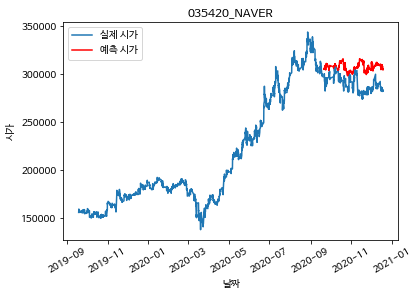

RMSE:  61933.85490232417
SMAPE:  15.428399955211592


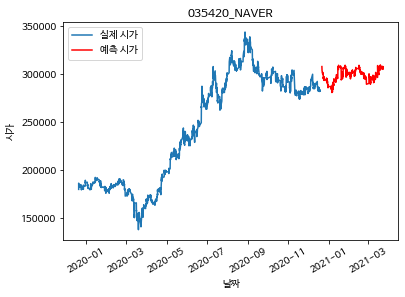

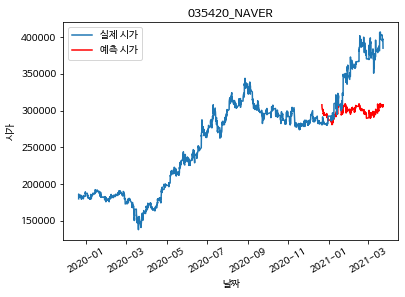

Mem. usage decreased to  4.83 Mb (64.3% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

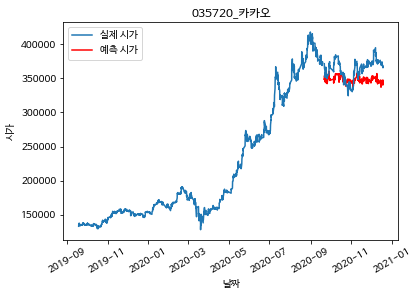

RMSE:  118053.73895365633
SMAPE:  27.707396560484668


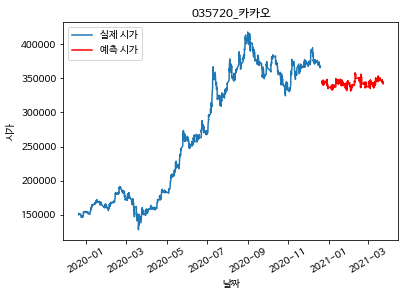

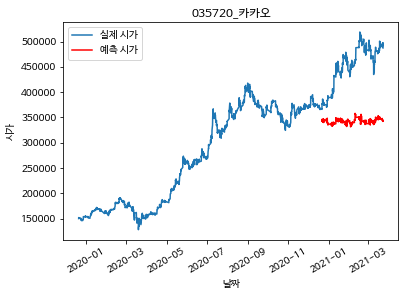

Mem. usage decreased to  4.49 Mb (66.5% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

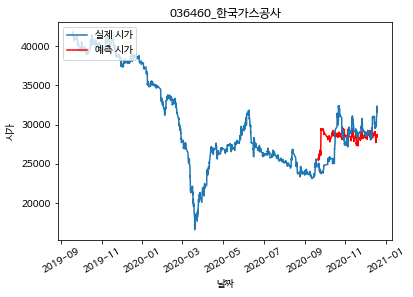

RMSE:  1765.0261687694576
SMAPE:  4.478002177824269


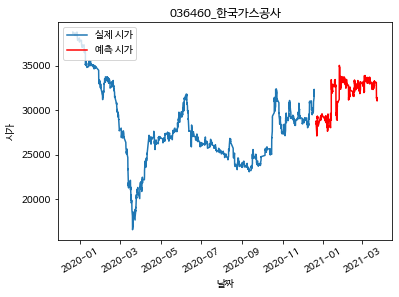

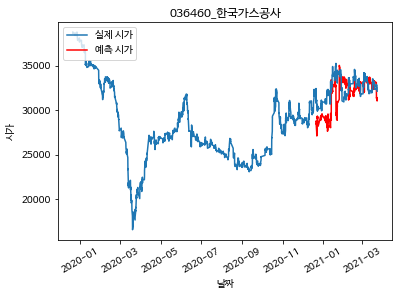

Mem. usage decreased to  4.89 Mb (63.5% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

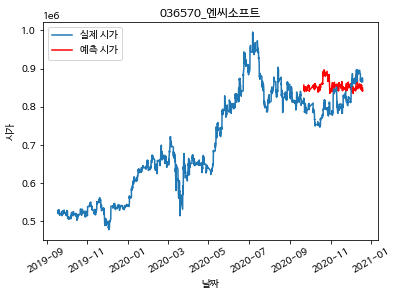

RMSE:  136908.5758075828
SMAPE:  14.492654559548635


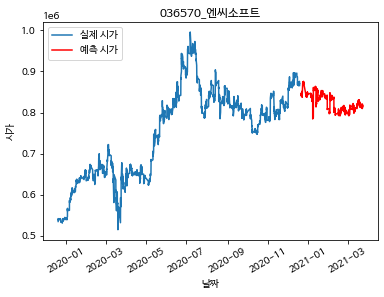

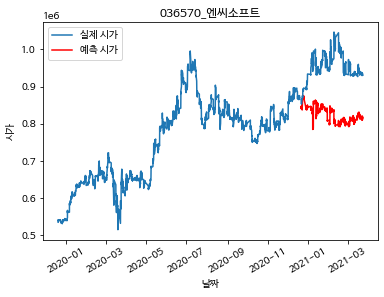

Mem. usage decreased to  4.58 Mb (64.9% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

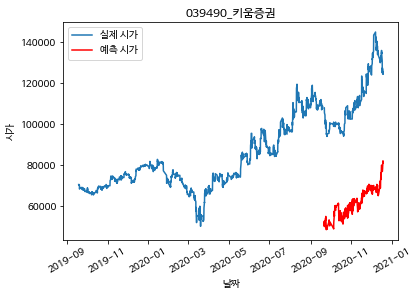

RMSE:  67261.70975343621
SMAPE:  62.078868400541644


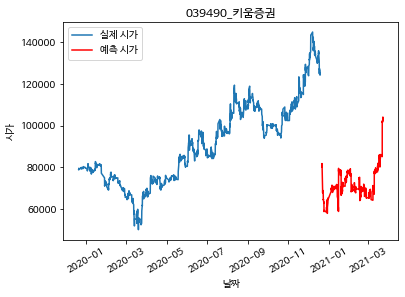

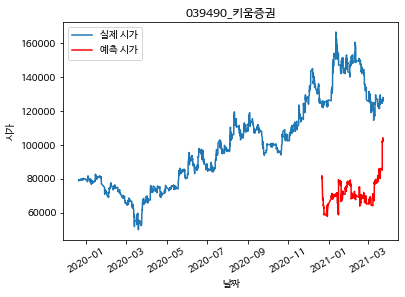

Mem. usage decreased to  4.65 Mb (65.1% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 702
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3105 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3066 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3105 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3079 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

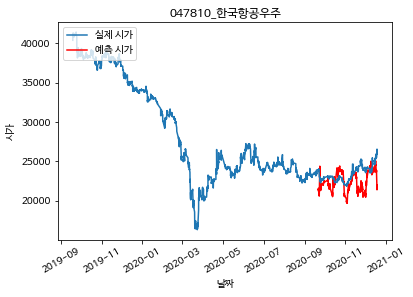

RMSE:  12865.79835526474
SMAPE:  44.55841247995877


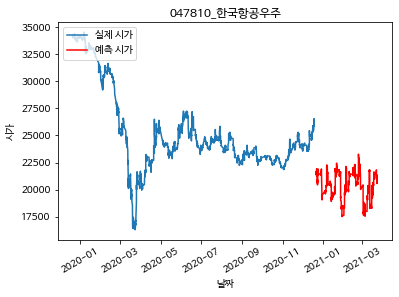

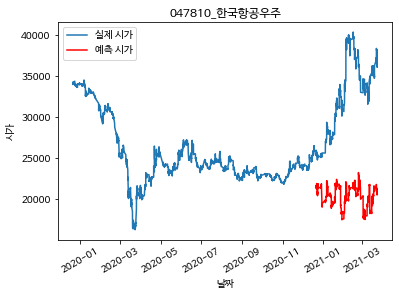

Mem. usage decreased to  4.80 Mb (64.2% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

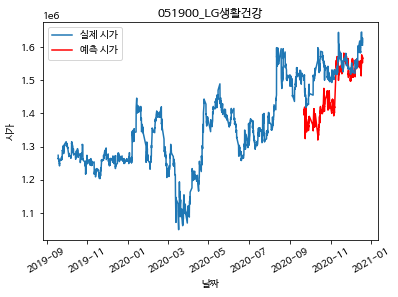

RMSE:  63987.05494539321
SMAPE:  3.360852532556879


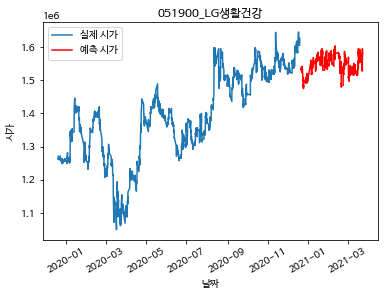

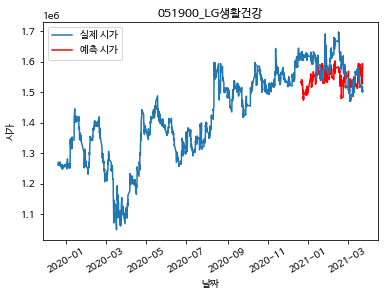

Mem. usage decreased to  4.92 Mb (63.6% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

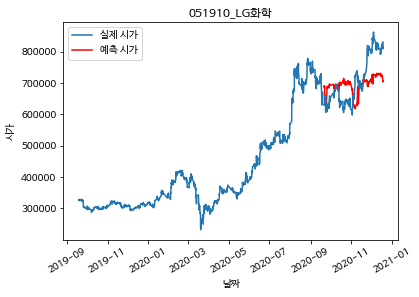

RMSE:  289622.5984371322
SMAPE:  35.51072634394961


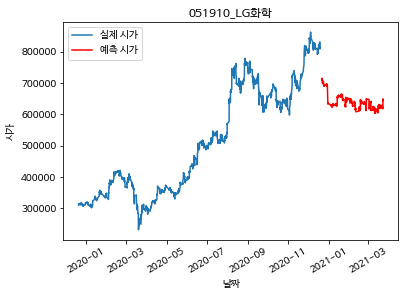

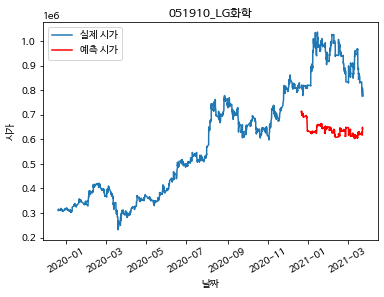

Mem. usage decreased to  4.40 Mb (66.3% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

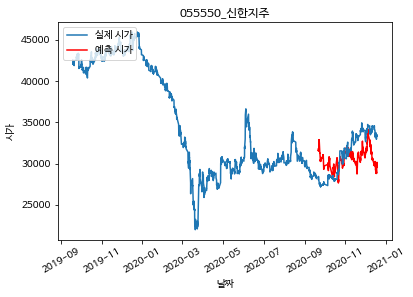

RMSE:  4660.784660935626
SMAPE:  14.37372342550813


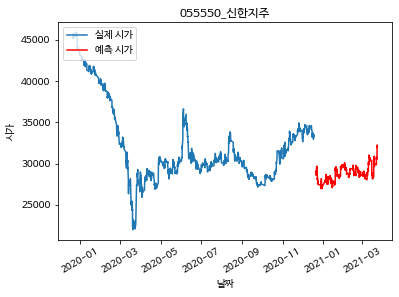

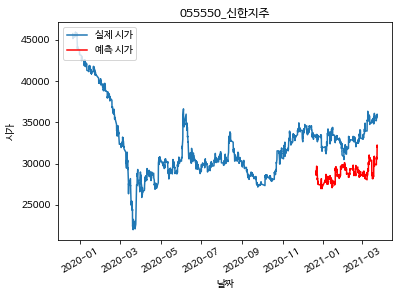

Mem. usage decreased to  4.80 Mb (64.2% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

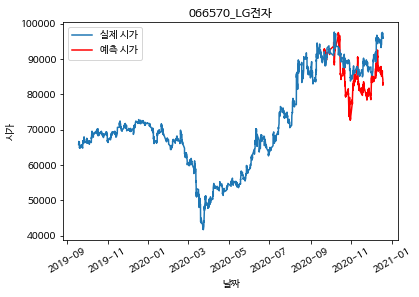

RMSE:  79536.10400194312
SMAPE:  66.89603960565924


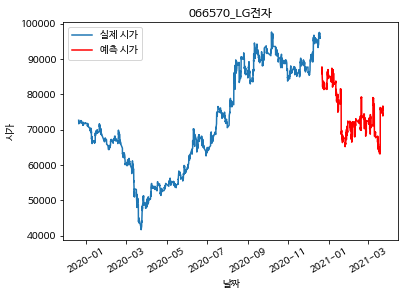

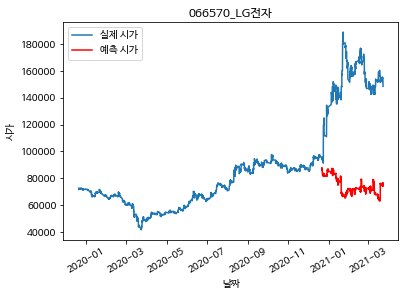

Mem. usage decreased to  4.74 Mb (64.7% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

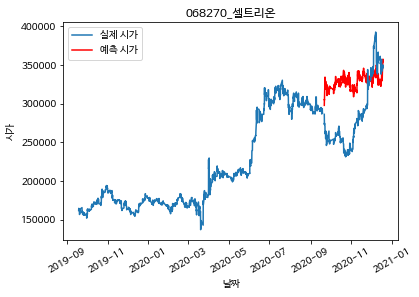

RMSE:  37151.7263117228
SMAPE:  10.22165102405664


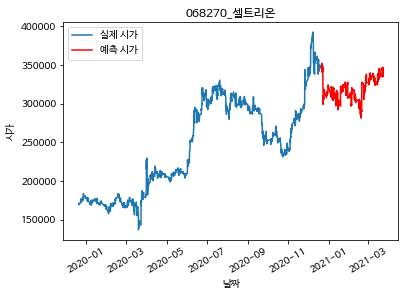

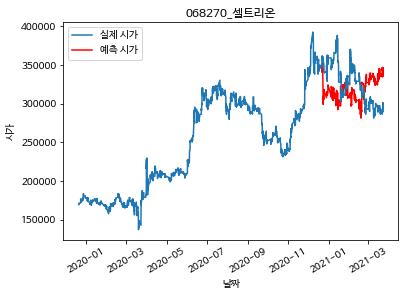

Mem. usage decreased to  4.74 Mb (64.0% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

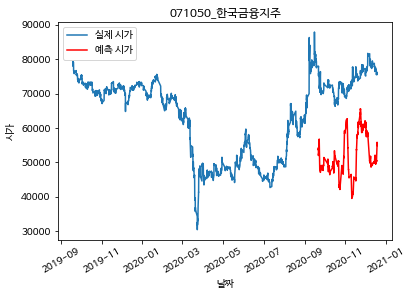

RMSE:  31992.240045551458
SMAPE:  44.62380612941471


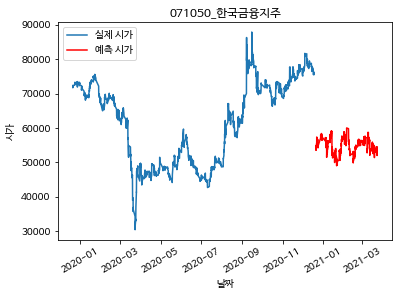

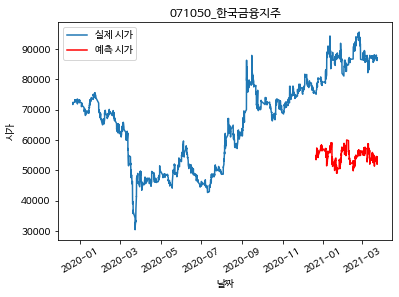

Mem. usage decreased to  4.77 Mb (64.8% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

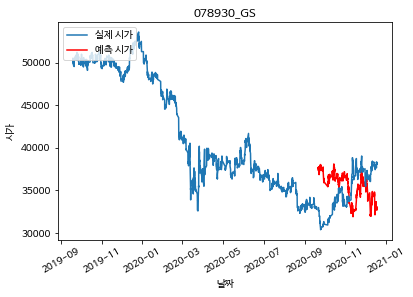

RMSE:  5165.076863460467
SMAPE:  13.44131913613301


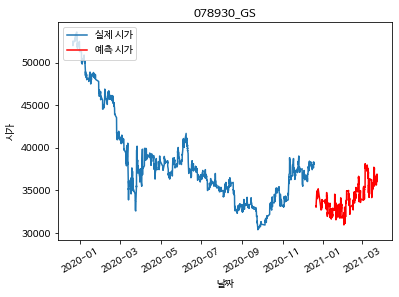

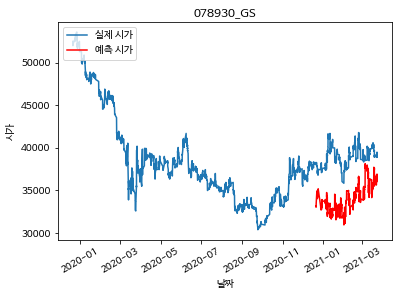

Mem. usage decreased to  4.86 Mb (64.1% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

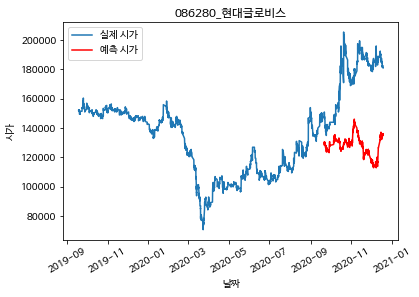

RMSE:  75747.39228869307
SMAPE:  46.5045432419336


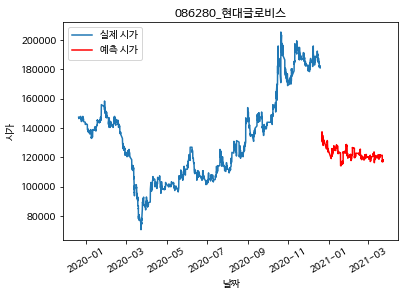

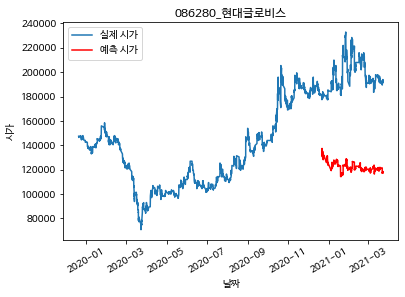

Mem. usage decreased to  4.34 Mb (67.1% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

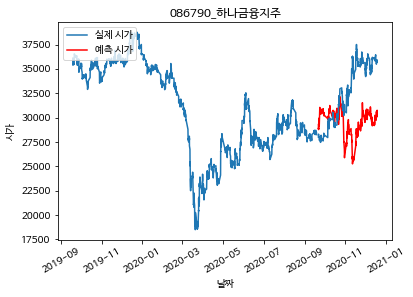

RMSE:  10177.806016819479
SMAPE:  29.62463039307766


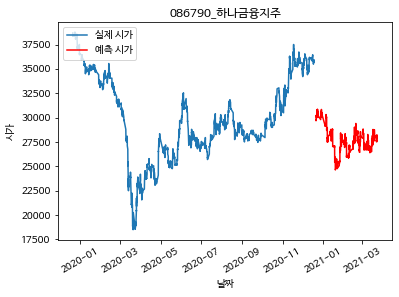

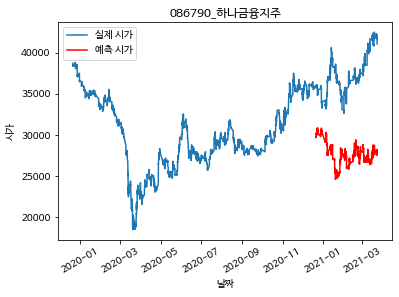

Mem. usage decreased to  4.80 Mb (64.5% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

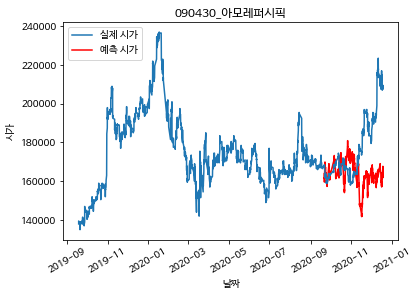

RMSE:  38419.38314458465
SMAPE:  16.533653871037345


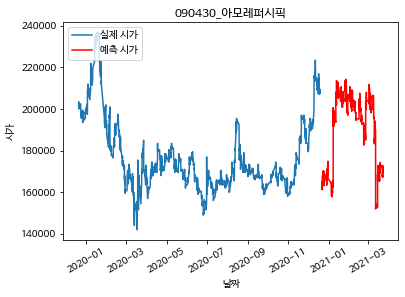

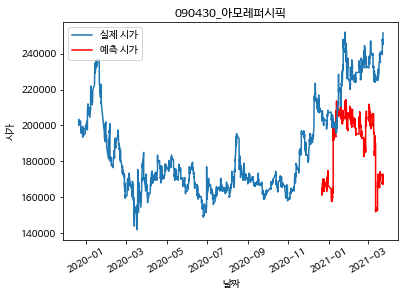

Mem. usage decreased to  4.86 Mb (64.1% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

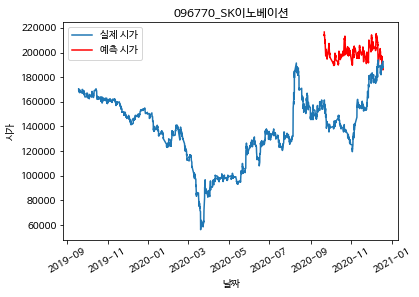

RMSE:  64391.71052246052
SMAPE:  22.638564127512307


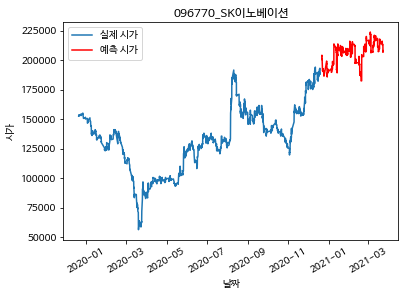

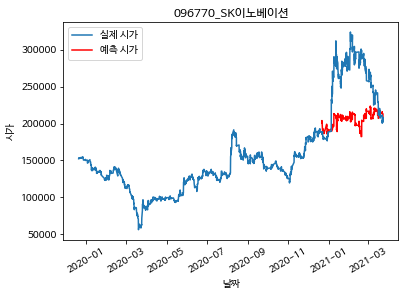

Mem. usage decreased to  4.80 Mb (64.5% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

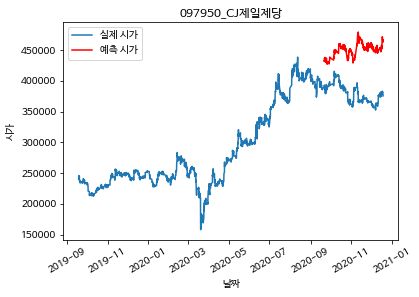

RMSE:  48797.35348162634
SMAPE:  9.773569371494657


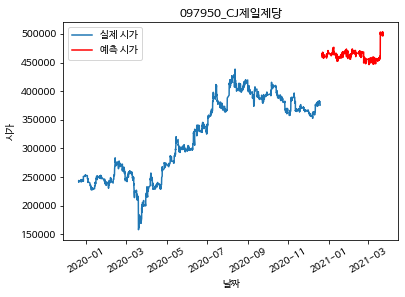

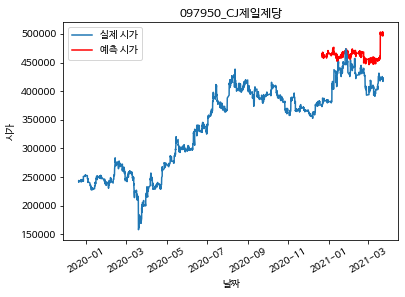

Mem. usage decreased to  4.65 Mb (64.7% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

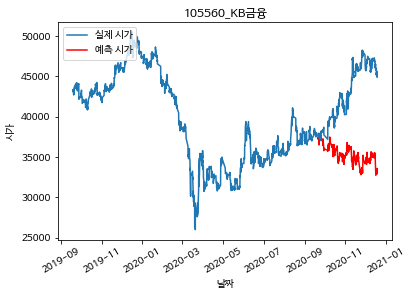

RMSE:  9009.78277010518
SMAPE:  20.90205614825913


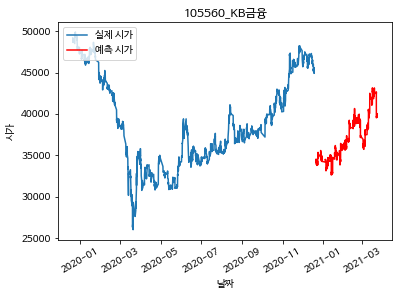

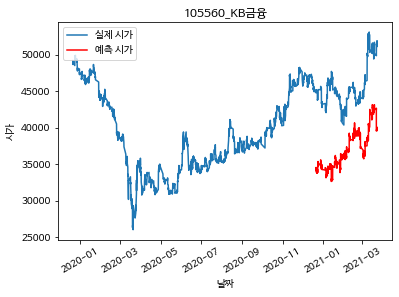

Mem. usage decreased to  4.80 Mb (64.5% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

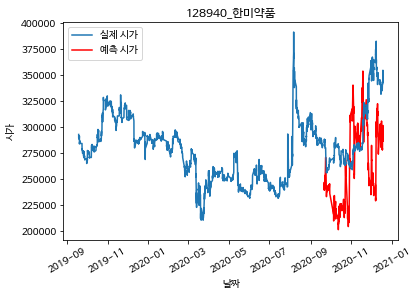

RMSE:  78289.74177414658
SMAPE:  23.27103646914704


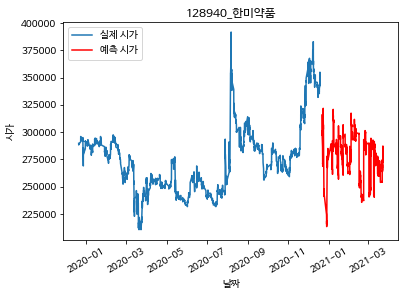

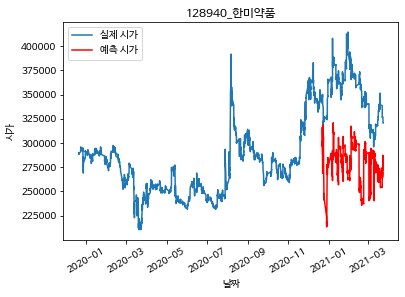

Mem. usage decreased to  4.80 Mb (64.5% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

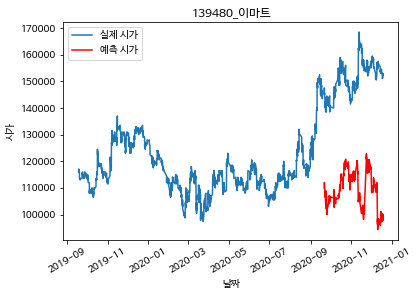

RMSE:  77203.59694918223
SMAPE:  56.86835629356594


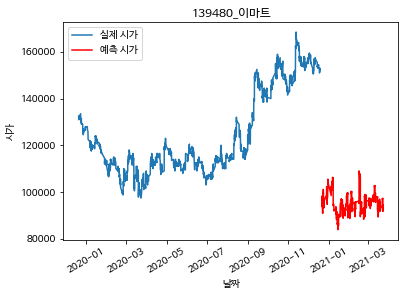

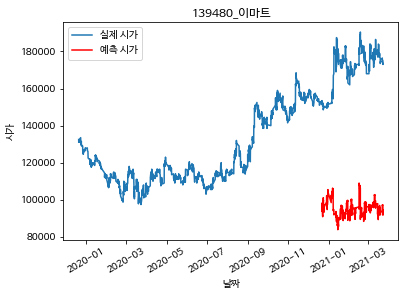

Mem. usage decreased to  4.61 Mb (65.9% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

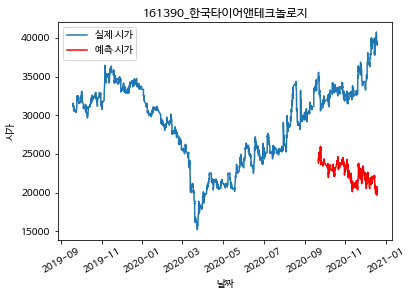

RMSE:  22983.232980218487
SMAPE:  67.63797397287124


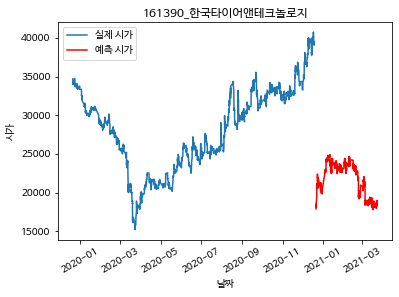

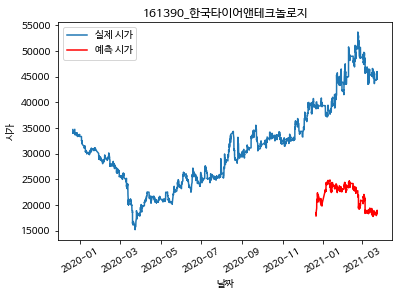

Mem. usage decreased to  4.71 Mb (65.2% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 793
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3183 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3157 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3157 , # test records 765
Train

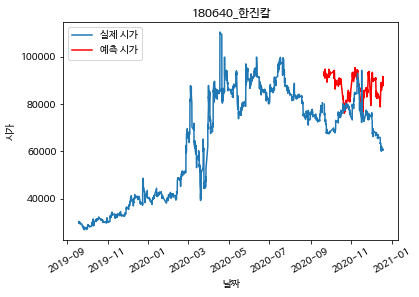

RMSE:  27422.117683801782
SMAPE:  35.91561135515953


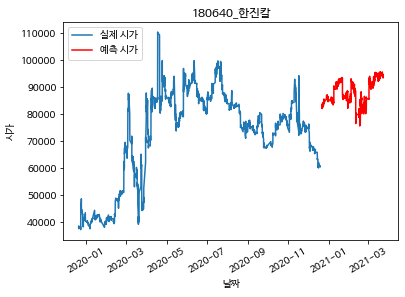

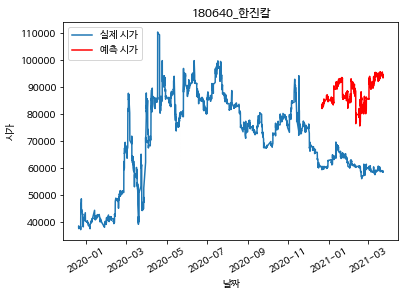

Mem. usage decreased to  4.70 Mb (65.2% reduction)
Train period: 2016-02-18 - 2017-02-18 , Test period 2017-02-18 - 2017-05-18 # train records 3111 , # test records 754
Train period: 2016-05-18 - 2017-05-18 , Test period 2017-05-18 - 2017-08-18 # train records 3157 , # test records 832
Train period: 2016-08-18 - 2017-08-18 , Test period 2017-08-18 - 2017-11-18 # train records 3209 , # test records 780
Train period: 2016-11-18 - 2017-11-18 , Test period 2017-11-18 - 2018-02-18 # train records 3183 , # test records 778
Train period: 2017-02-18 - 2018-02-18 , Test period 2018-02-18 - 2018-05-18 # train records 3144 , # test records 754
Train period: 2017-05-18 - 2018-05-18 , Test period 2018-05-18 - 2018-08-18 # train records 3144 , # test records 806
Train period: 2017-08-18 - 2018-08-18 , Test period 2018-08-18 - 2018-11-18 # train records 3118 , # test records 780
Train period: 2017-11-18 - 2018-11-18 , Test period 2018-11-18 - 2019-02-18 # train records 3118 , # test records 765
Train

In [ ]:
for A_jongmoc in range(len(data_list)):
    jongmoc = jongmoc_list[A_jongmoc]
    jongmoc_name = data_list[A_jongmoc][1:]
    #path_data="dcloud-global-dir/data_merge_fix/"
    path_data = 'data_merge_fix/'
    #directory = "dcloud-global-dir/lgbm result/1차/"
    directory = 'lgbm result/3차/'
    real_data=pd.read_csv(path_data+jongmoc+'_merge_FSO_fix.csv', encoding='cp949')
    # 원본 데이터 1.6만행
    real_data['time_idx']=real_data.index
    real_data.Date=pd.to_datetime(real_data.Date,format='%Y%m%d%H%M')
    real_data.Open	=real_data.Open.astype(float)
    #data.Profit=data.Profit.astype(float)
    #data.Volatility	=data.Volatility.astype(float)
    #real_data["code"]= 0
    data = real_data.copy()
    data.dropna()
    #data = data[:-4806]
    #data #train + val, ~2019/09/20
    
    data_for_modeling= data

    #### Example- compute average test sets score: ####
    X = data_for_modeling
    y = data_for_modeling['Open']

    '''add_lag_feature(X, ['Open','High','Low','Close','Open_D','High_D','Low_D','Close_D'], window=12*5)
    add_lag_feature(X, ['Open','High','Low','Close','Open_D','High_D','Low_D','Close_D'],  window=12*10)
    add_lag_feature(X, ['Open','High','Low','Close','Open_D','High_D','Low_D','Close_D'], window=12*30)
    add_lag_feature(X,['Open','High','Low','Close','Open_D','High_D','Low_D','Close_D'],  window=12*60)'''

    # Reducing memory
    X = reduce_mem_usage(X)
    #y = reduce_mem_usage(test_df)

    from datetime import datetime
    split_date2 = datetime.strptime('202012200930', '%Y%m%d%H%M')
    split_date1 = datetime.strptime('202009190930', '%Y%m%d%H%M')
    split_date0 = datetime.strptime('202006250930', '%Y%m%d%H%M')

    last_date2 = datetime.strptime('201912200930', '%Y%m%d%H%M')
    last_date1 = datetime.strptime('201909180930', '%Y%m%d%H%M')

    X_test2 = X[(pd.to_datetime(X["Date"]) >= split_date2)]
    X_test1 = X[(pd.to_datetime(X["Date"]) >= split_date1) & (pd.to_datetime(X["Date"]) < split_date2)]
    X_test0 = X[(pd.to_datetime(X["Date"]) >= split_date0) & (pd.to_datetime(X["Date"]) < split_date1)]
    X_test_whole = X[(pd.to_datetime(X["Date"])>= split_date0)]

    X_train = X[(pd.to_datetime(X["Date"]) < split_date1)]
    X_train_whole = X[(pd.to_datetime(X["Date"]) < split_date2)]

    X_last2 = X[(pd.to_datetime(X["Date"]) >= last_date2) & (pd.to_datetime(X["Date"]) < split_date2)]
    X_last1 = X[(pd.to_datetime(X["Date"]) >= last_date1) & (pd.to_datetime(X["Date"]) < split_date1)]



    y_test2 = X_test2['Open']
    y_test1 = X_test1['Open']
    y_test_whole = X_test_whole['Open']

    y_train = X_train_whole['Open']
    y_last2 = X_last2['Open']
    y_last1 = X_last1['Open']

    y_lag = y_train.shift(-793)
    y_lag_date = X_train.shift(-793)['Date']
    y_shift_date = X_train.shift(793)['Date']

    y_lag_test_whole = y_test_whole.shift(-793)
    y_shift_date_test = X_test1.shift(793)

    #X_test2  = X_test2[:,sel_feature]
    #X_test1  = X_test1[:,sel_feature]
    #X_train = X_train[:,sel_feature]
    #X_test_whole = X_test_whole[:,sel_feature]
    tscv = TimeBasedCV(train_period=12,
                   test_period=3,
                   freq='months')

    model=None
    SMAPE_list=[]
    n=0
    import datetime

    for train_index, test_index in tscv.split(X_train,
                        validation_split_date=datetime.date(2017,2,18), date_column='Date'):#, gap=90):
        #print(train_index, test_index)
        date_train = y_lag_date.loc[train_index]
        data_train   = X_train.loc[train_index].drop(['Date','key_date'], axis=1)
        target_train = y_lag.loc[train_index]

        date_val = y_lag_date.loc[test_index]
        data_val    = X_train.loc[test_index].drop(['Date','key_date'], axis=1)
        target_val  = y_lag.loc[test_index]


        date_future = y_shift_date.loc[test_index]
        #target_future  = y_train.loc[test_index]
        hyper_params = {
            'n_estimators': 1000,
            'colsample_bytree': 0.8,
            'max_depth': 100,
            'num_leaves': 100,
            'learning_rate':0.01
        }
        hyper_params['task'] = 'train'
        hyper_params['objective'] = 'regression l2'
        hyper_params['keep_training_booster'] = True
        hyper_params['boosting_type'] = 'gbdt'
        hyper_params['num_iterations'] = 2000
        #hyper_params['n_estimators'] = 1000

        
        #모델
        train_ds = lgb.Dataset(data_train, label=target_train)
        test_ds = lgb.Dataset(data_val, label = target_val)
        #model = lgb.train(hyper_params, train_ds, 2000, test_ds, verbose_eval=500, early_stopping_rounds=100, init_model=model)

        model = LGBMRegressor(**hyper_params)#, init_model=model)
        #model.fit(data_train, target_train)#, eval_set=[(data_test, target_test)])
        model.fit(data_train,target_train,eval_set=[(data_val,target_val)],early_stopping_rounds=100,verbose=False)


        feature_importance = pd.DataFrame({'Value':model.feature_importances_,'Feature':data_train.columns}).sort_values(by="Value",ascending=False)
        sel_feature = feature_importance[feature_importance.Value>0]
        sel_feature = sel_feature.iloc[:,1].tolist()
        
    if 'Date' not in sel_feature:
        sel_feature.append('Date')
            
    X_test2  = X_test2[sel_feature]
    X_test1  = X_test1[sel_feature]
    X_test0  = X_test0[sel_feature]
    X_train = X_train[sel_feature]
    #X_train['Date']= X_train['Date'].dt
    X_test_whole = X_test_whole[sel_feature]
    
    X_train_opt = X_train.copy()
    X_train_opt = X_train_opt.drop(['Date'], axis=1)
    hyper_params = bayesion_opt_lgbm(X_train_opt, y_lag[:len(X_train_opt)], init_iter=5, n_iters=10, random_state=77, seed = 101, num_iterations = 200)

    model=None
    SMAPE_list=[]
    n=0
    
    for train_index, test_index in tscv.split(X_train,
                   validation_split_date=datetime.date(2017,2,18), date_column='Date'):#, gap=90):
        #print(train_index, test_index)
        date_train = y_lag_date.loc[train_index]
        data_train   = X_train.loc[train_index].drop(['Date'], axis=1)
        target_train = y_lag.loc[train_index]

        date_val = y_lag_date.loc[test_index]
        data_val    = X_train.loc[test_index].drop(['Date'], axis=1)
        target_val  = y_lag.loc[test_index]

        date_future = y_shift_date.loc[test_index]
        #target_future  = y_train.loc[test_index]
        hyper_params['task'] = 'train'
        hyper_params['objective'] = 'regression l2'
        hyper_params['keep_training_booster'] = True
        hyper_params['boosting_type'] = 'dart'
        hyper_params['num_iterations'] = 1000
        #hyper_params['n_estimators'] = 1000
        hyper_params['num_leaves'] = int(hyper_params['num_leaves'])
        hyper_params['max_depth'] = int(hyper_params['max_depth'])

        try: 
            #모델
            train_ds = lgb.Dataset(data_train, label=target_train)
            test_ds = lgb.Dataset(data_val, label = target_val)
            model = lgb.train(hyper_params, train_ds, 1000, test_ds, verbose_eval=500, early_stopping_rounds=100, init_model=model)

            #model = LGBMRegressor(**hyper_params)#, init_model=model)
            #model.fit(data_train, target_train)#, eval_set=[(data_test, target_test)])
            #model.fit(data_train,target_train,eval_set=[(data_val,target_val)],early_stopping_rounds=100,verbose=False)


            #predict_train = model.predict(data_train)
            predict_val = model.predict(data_val)
            #print('The rmse of prediction is:', mean_squared_error(predict_val, target_val) ** 0.5)

            mse = mean_squared_error(target_val, predict_val)
            r2 = r2_score(target_val, predict_val)
            #print('Mean squared error: ', mse)
            #print('R2 score: ', r2)
            #print('SMAPE: ', smape(predict_val, target_val))

            SMAPE_list.append(smape(predict_val, target_val))
            #save_model
            joblib.dump(model, str(n)+'lgb.pkl')

            #sns_plot = sns.regplot(x = 'Value', y = 'predict', data = final_result)
            '''plt.plot(date_train, target_train, color="tab:blue")
            plt.plot(date_val, predict_val, color="red")
            plt.plot(date_val,  target_val, color="orange")
            plt.xticks(rotation=45)
            plt.legend(['Train','Prediction'])
            plt.show()'''

            n+=1
        except ValueError:
            pass
        #plt.savefig(directory+jongmoc+'LGBM_performance.png')

    #get best model
    print(SMAPE_list)
    a = SMAPE_list.index(min(SMAPE_list))

    best_model = joblib.load(str(a)+'lgb.pkl')
    
    #get performance
    X_test0_do = X_test0.drop(['Date'],axis=1)
    y_pred1 = model.predict(X_test0_do)
    y_test1 = y_lag_test_whole[:len(y_pred1)]
    #print(y_test1)
    smape_test = round(smape(y_pred1, y_test1),3)
    print('SMAPE: ', smape(y_pred1, y_test1))
    test_result1 = pd.concat([X_last1['Date'].reset_index(drop=True), y_last1.reset_index(drop=True)], axis=1)
    test_result2 = pd.concat([X_test1['Date'].reset_index(drop=True), y_test1.reset_index(drop=True), pd.DataFrame(y_pred1)], axis = 1)
    test_result = pd.concat([test_result1, test_result2], axis=0)
    test_result.columns = ['Date','Open','predict']
    test_result.to_csv(directory+jongmoc+"_performance1.csv",index=False)

    #performance plot save
    plt.plot(X_last1['Date'],y_last1, color="tab:blue")
    plt.plot(X_test1['Date'],y_pred1[:len(X_test1)], color="red")
    plt.plot(X_test1['Date'],y_test1[:len(X_test1)],color="tab:blue")
    plt.xticks(rotation=30)
    plt.legend(['실제 시가','예측 시가'],loc='upper left')
    plt.xlabel("날짜")
    plt.ylabel("시가")
    plt.title(jongmoc_name)
    plt.savefig(directory+jongmoc+'.LGBM_performance1.png')
    plt.show()
    plt.clf()
    
    #get final prediction
    y_lag_test_whole = y_lag_test_whole.dropna()
    X_test1_do = X_test1.drop(['Date'],axis=1)
    y_pred2 = model.predict(X_test1_do)
    y_test2 = y_lag_test_whole[-len(y_pred2):]
    
    smape_test = round(smape(y_pred2, y_test2),3)
    print('RMSE: ',np.sqrt(np.mean((y_pred2 - y_test2)**2)))
    print('SMAPE: ', smape(y_pred2, y_test2))

    real_result1 = pd.concat([X_last2['Date'].reset_index(drop=True), y_last2.reset_index(drop=True)], axis = 1)
    real_result2 = pd.concat([X_test2['Date'].reset_index(drop=True), pd.DataFrame(y_pred2)], axis = 1)
    real_result2.columns = ['Date','예측 시가']

    real_result_ans = pd.concat([X_test2['Date'].reset_index(drop=True), y_test2.reset_index(drop=True), pd.DataFrame(y_pred2)], axis = 1)
    real_result_ans = pd.concat([real_result1, real_result_ans], axis=0)
    real_result_ans.columns = ['Date','실제 시가','예측 시가']
    real_result2.to_csv(directory+jongmoc+"_prediction1.csv",index=False)
    real_result_ans.to_csv(directory+jongmoc+"_prediction_REAL1.csv",index=False)

    #prediction plot save
    plt.plot(X_last2['Date'],y_last2, color="tab:blue")
    plt.plot(X_test2['Date'],y_pred2[:len(X_test2)], color="red")
    #plt.plot(X_test2['Date'],y_test2[:len(X_test2)],color="orange")
    plt.xticks(rotation=30)
    plt.legend(['실제 시가','예측 시가'],loc='upper left')
    plt.xlabel("날짜")
    plt.ylabel("시가")
    plt.title(jongmoc_name)
    plt.savefig(directory+jongmoc+'.LGBM_prediction1.png')
    plt.show()
    plt.clf()
    
    #prediction plot answer save
    plt.plot(X_last2['Date'],y_last2, color="tab:blue")
    plt.plot(X_test2['Date'],y_pred2[:len(X_test2)], color="red")
    plt.plot(X_test2['Date'],y_test2[:len(X_test2)],color="tab:blue")
    plt.xticks(rotation=30)
    plt.legend(['실제 시가','예측 시가'],loc='upper left')
    plt.xlabel("날짜")
    plt.ylabel("시가")
    plt.title(jongmoc_name)
    plt.savefig(directory+jongmoc+'.LGBM_predictionREAL1.png')
    plt.show()
    plt.clf()

    memory.clear(warn=False)